In [1]:
# Importo las librerias
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns
# Librerías Sklearn
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.decomposition import PCA as sklearnPCA
from sklearn.svm import SVR
from sklearn.svm import LinearSVR
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsRegressor as KN
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, accuracy_score
from sklearn.model_selection import GridSearchCV
from datetime import datetime as dt
# Librerías para el mapa interactivo
!conda install -c conda-forge folium=0.5.0 --yes 
import folium 
import webbrowser
from folium import plugins
from folium.plugins import HeatMap
# Importamos librerias de Clustering
from sklearn.cluster import KMeans
from sklearn.neighbors import KNeighborsClassifier
from scipy.cluster.hierarchy import dendrogram, linkage 
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import confusion_matrix
from sklearn import metrics

Solving environment: done

# All requested packages already installed.



Trabajaremos con un dataset obtenido de https://data.buenosaires.gob.ar
Link al dataset: https://data.buenosaires.gob.ar/dataset/delitos

# Importamos los 4 archivos por los cuales está compuesto nuestro Dataset

In [2]:
Delitos_16 = pd.read_csv(r'delitos_2016.csv', delimiter=',', parse_dates = True)
Delitos_17 = pd.read_csv(r'delitos_2017.csv', delimiter=',', parse_dates = True)
Delitos_18 = pd.read_csv(r'delitos_2018.csv', delimiter=',', parse_dates = True)
Delitos_19 = pd.read_csv(r'delitos_2019.csv', delimiter=',', parse_dates = True)

# Preparación y limpieza del Dataset

Creamos nuestro dataset principal en base a los importados anteriormente

In [3]:
Delitos_full=Delitos_16.append(Delitos_17)
Delitos_full=Delitos_full.append(Delitos_18)
Delitos_full=Delitos_full.append(Delitos_19)
print('nuestro dataset consta de:', Delitos_full.shape[0], 'samples y', Delitos_full.shape[1],'Features')

nuestro dataset consta de: 488541 samples y 10 Features


Analizamos los valores Nan

In [4]:
Delitos_full.isnull().sum()

id                          0
fecha                       0
franja_horaria              0
tipo_delito                 0
subtipo_delito         419364
cantidad_registrada         0
comuna                   8364
barrio                   8364
lat                      8364
long                     8364
dtype: int64

Eliminamos las features que no nos resultan útiles para nuestro análisis

In [5]:
Delitos_full.drop(['id','subtipo_delito'], axis=1, inplace=True)
Delitos_full.isnull().sum()

fecha                     0
franja_horaria            0
tipo_delito               0
cantidad_registrada       0
comuna                 8364
barrio                 8364
lat                    8364
long                   8364
dtype: int64

In [6]:
print('Los valores nulos representan el',round((Delitos_full.comuna.isnull().sum()/Delitos_full.comuna.count())*100,2),'%')

Los valores nulos representan el 1.74 %


Procedemos a eliminar las filas con valores nulos, debido a que no representan una cantidad significativa

In [7]:
Delitos_full.dropna(subset=['comuna','barrio', 'lat','long'], inplace=True) 

In [8]:
Delitos_full.isnull().sum()

fecha                  0
franja_horaria         0
tipo_delito            0
cantidad_registrada    0
comuna                 0
barrio                 0
lat                    0
long                   0
dtype: int64

Transformamos los valores de 'comuna' a valores enteros

In [9]:
Delitos_full.comuna = Delitos_full.comuna.astype(int) 

## Importamos un dataset auxiliar que contiene los barrios, precio promedio del m2, comuna y promedio de ingresos por hogar

In [10]:
barrio_ingresos = pd.read_excel('barrio_ingresos.xlsx')

## Mergeamos los datasets, usando como key la columna 'barrio' de ambos

In [11]:
Delitos_full = Delitos_full.merge(barrio_ingresos, left_on = 'barrio', right_on = 'barrio', how = 'left')
Delitos_full.head()

,fecha,franja_horaria,tipo_delito,cantidad_registrada,comuna_x,barrio,lat,long,Unnamed: 0,precio_prom,comuna_y,Promedio IPCF
0,2016-01-01,13,Robo (con violencia),1.0,9,Parque Avellaneda,-34.648730,-58.468536,40,1599.600000,9,23131
1,2016-01-01,22,Robo (con violencia),1.0,14,Palermo,-34.576925,-58.407400,2,3037.840909,14,54481
2,2016-01-01,1,Lesiones,1.0,4,Parque Patricios,-34.645197,-58.401099,38,1738.361702,4,21631
3,2016-01-01,19,Hurto (sin violencia),1.0,9,Parque Avellaneda,-34.655760,-58.478681,40,1599.600000,9,23131
4,2016-01-01,4,Robo (con violencia),1.0,6,Caballito,-34.624128,-58.436826,12,2350.152174,6,39050


Eliminamos las features repetidas o las que no tienen ninguna utilidad para el análisis

In [12]:
Delitos_full.drop(['Unnamed: 0','comuna_y'], axis = 1, inplace = True)

Renombramos algunas features para facilitar su uso

In [13]:
Delitos_full = Delitos_full.rename(columns={'precio_prom': 'Precio_m2', 'Promedio IPCF': 'Ingresos'})

In [14]:
Delitos_full = Delitos_full.rename(columns={'comuna_x': 'comuna'})

In [15]:
Delitos_full.shape

(480177, 10)

## Renombramos features y verificamos como queda nuestro dataset

In [16]:
Delitos_full = Delitos_full.rename(columns = {'fecha':'Fecha','franja_horaria':'Hora','tipo_delito':'Tipo','cantidad_registrada':'Cantidad','comuna':'Comuna','barrio':'Barrio','lat':'Latitud','long':'Longitud'})
Delitos_full.head()

,Fecha,Hora,Tipo,Cantidad,Comuna,Barrio,Latitud,Longitud,Precio_m2,Ingresos
0,2016-01-01,13,Robo (con violencia),1.0,9,Parque Avellaneda,-34.648730,-58.468536,1599.600000,23131
1,2016-01-01,22,Robo (con violencia),1.0,14,Palermo,-34.576925,-58.407400,3037.840909,54481
2,2016-01-01,1,Lesiones,1.0,4,Parque Patricios,-34.645197,-58.401099,1738.361702,21631
3,2016-01-01,19,Hurto (sin violencia),1.0,9,Parque Avellaneda,-34.655760,-58.478681,1599.600000,23131
4,2016-01-01,4,Robo (con violencia),1.0,6,Caballito,-34.624128,-58.436826,2350.152174,39050


## Creamos nuevas features que contienen el año, mes y día de cada delito, para facilitar la manipulación
## Ordenamos el dataset de una manera mas conveniente

In [17]:
Delitos_full.Fecha = pd.to_datetime(Delitos_full.Fecha) 
Delitos_full['Año'] = Delitos_full.Fecha.dt.year 
Delitos_full['Mes'] = Delitos_full.Fecha.dt.month
Delitos_full['Dia'] = Delitos_full.Fecha.dt.day
# Eliminamos fecha
Delitos_full.drop(['Fecha'], axis=1, inplace=True)
# Ordenamos
Delitos_full=Delitos_full.reindex(columns=['Dia','Mes','Año','Hora','Tipo','Cantidad','Comuna','Barrio','Latitud','Longitud','Precio_m2','Ingresos'])
Delitos_full.head()

,Dia,Mes,Año,Hora,Tipo,Cantidad,Comuna,Barrio,Latitud,Longitud,Precio_m2,Ingresos
0,1,1,2016,13,Robo (con violencia),1.0,9,Parque Avellaneda,-34.648730,-58.468536,1599.600000,23131
1,1,1,2016,22,Robo (con violencia),1.0,14,Palermo,-34.576925,-58.407400,3037.840909,54481
2,1,1,2016,1,Lesiones,1.0,4,Parque Patricios,-34.645197,-58.401099,1738.361702,21631
3,1,1,2016,19,Hurto (sin violencia),1.0,9,Parque Avellaneda,-34.655760,-58.478681,1599.600000,23131
4,1,1,2016,4,Robo (con violencia),1.0,6,Caballito,-34.624128,-58.436826,2350.152174,39050


Para finalizar el proceso de preparación del Dataset, eliminamos algunas samples que tienen valores S/D en la hora y modificamos aquellas con hora 0 por 24

In [18]:
Delitos_full = Delitos_full[Delitos_full.Hora != 'S/D']
Delitos_full.Hora = Delitos_full.Hora.astype(int) 
Delitos_full.Hora = Delitos_full.Hora.replace(to_replace = 0,value = 24)

## El dataset ya se encuentra listo para el EDA

In [19]:
print('El tamaño final del dataset es de:',Delitos_full.shape[0],'samples y',Delitos_full.shape[1],'features')

El tamaño final del dataset es de: 480134 samples y 12 features


# Exploratory data analysis (EDA)

## Cantidad de delitos totales por barrio 

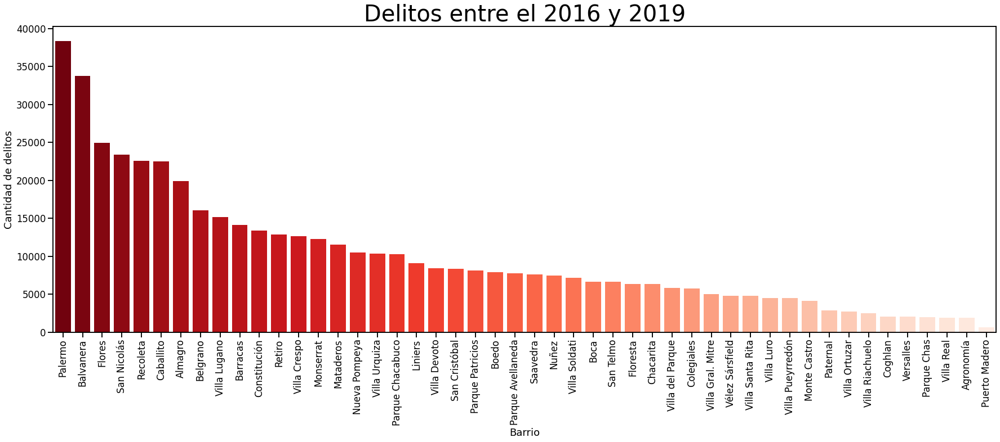

In [20]:
diverging_colors = sns.color_palette("Reds_r", 50) # Color de las barras
sns.set_context("talk")
plt.figure(figsize=(30, 10))
az = sns.countplot(x="Barrio", data=Delitos_full, saturation=1.5, order = Delitos_full['Barrio'].value_counts().index, palette = diverging_colors)
plt.xticks(rotation=90)
plt.title("Delitos entre el 2016 y 2019", fontsize = 40)
plt.ylabel("Cantidad de delitos")
plt.show()

Vemos que Palermo es el barrio con mas delitos en el período analizado

## Hora a la que se cometen mayor cantidad de delitos 

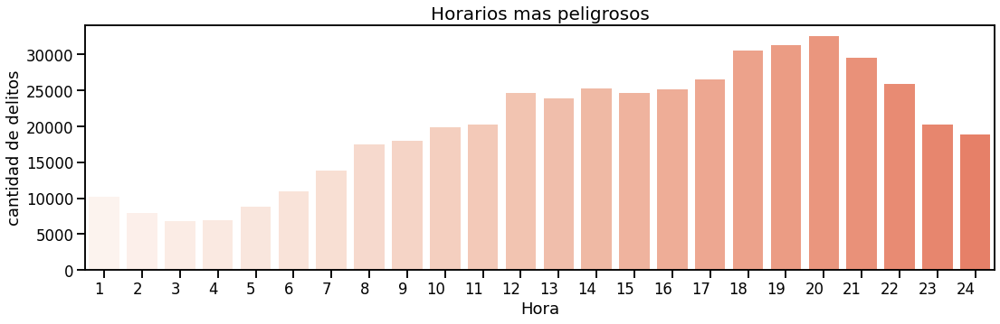

In [21]:
plt.figure(figsize=(18,5))
diverging_colors = sns.color_palette("Reds", 50)
orden = list(range(1,25))
g = sns.countplot(x=Delitos_full.Hora,data=Delitos_full,order = orden, palette = diverging_colors)
g.set_xticklabels(g.get_xticklabels(), ha="right")
plt.title('Horarios mas peligrosos',size = 20)
plt.xlabel("Hora")
plt.ylabel("cantidad de delitos")
plt.show()

## Boxplot por cada tipo de delito

<AxesSubplot:xlabel='Tipo', ylabel='Hora'>

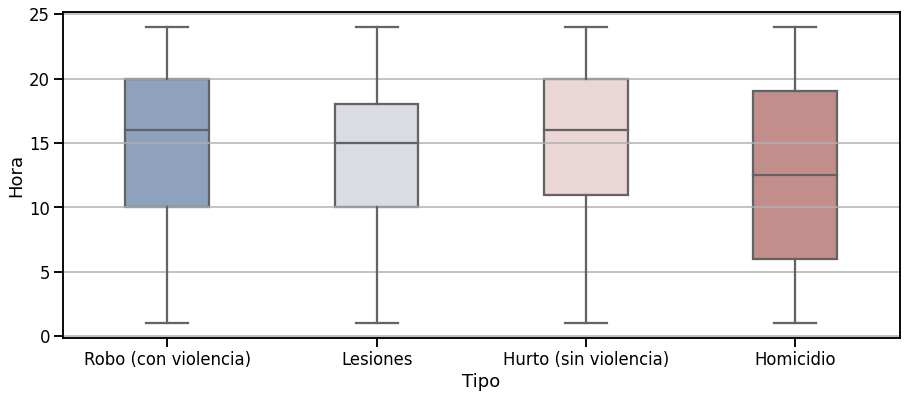

In [22]:
plt.figure(figsize=(15, 6))
plt.grid(True)
sns.boxplot(x = Delitos_full.Tipo, y = Delitos_full.Hora, width = 0.4, palette="vlag")


Creamos un nuevo dataframe con la cantidad de delitos por tipo y por año

In [23]:
tipo = Delitos_full.Cantidad.groupby([Delitos_full.Tipo , Delitos_full.Año]).sum().to_frame()
tipo = tipo.reset_index()

## Gráfico de torta para ver la distribución de los delitos por tipo

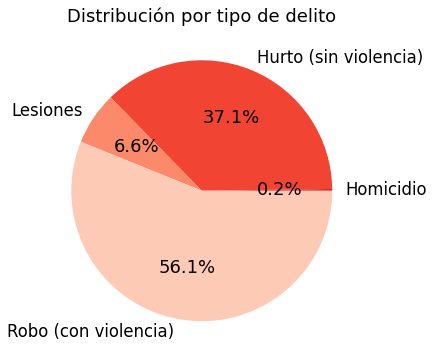

In [24]:
# Tabla auxiliar
torta = tipo.groupby(tipo.Tipo).sum()
torta.drop(['Año'], axis = 1, inplace = True)

# Gráfico
diverging_colors = sns.color_palette("Reds_r", 4) # Color de las barras
fig, ax = plt.subplots(figsize = (12,6))
ax.pie(torta.Cantidad, labels = torta.index, autopct='%1.1f%%', colors = diverging_colors)
plt.title('Distribución por tipo de delito')
plt.show()

Filtro al dataframe para graficar por tipo de delito y la evolución año a año

In [25]:
hurtos = tipo.loc[tipo.Tipo == 'Hurto (sin violencia)']
robos = tipo.loc[tipo.Tipo == 'Robo (con violencia)']
lesiones = tipo.loc[tipo.Tipo == 'Lesiones']
homicidios= tipo.loc[tipo.Tipo == 'Homicidio' ]

## Hurtos y robos. Evolución año a año

([<matplotlib.axis.XTick at 0x7ff10e41ed90>,
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

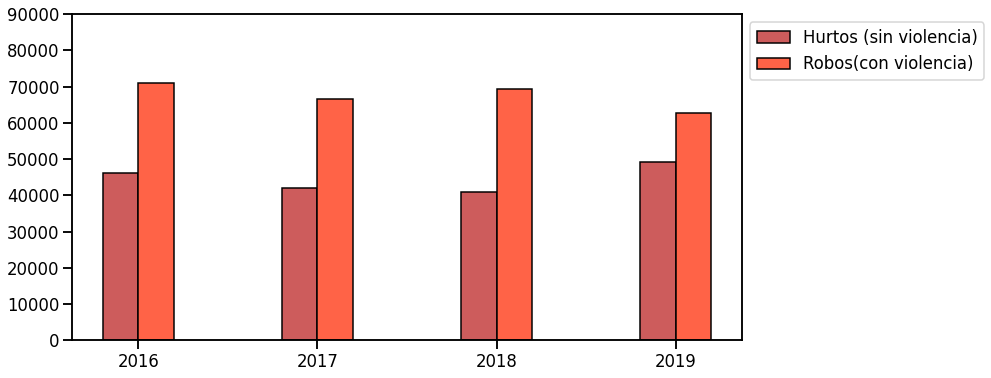

In [26]:
w = 0.2
fig, ax1 = plt.subplots(figsize = (12,6))
hurtos_por_año = ax1.bar(hurtos.Año-w/2, hurtos.Cantidad ,color = 'indianred', width = w , label = 'Hurtos (sin violencia)', ec = 'k')
robos_por_año = ax1.bar(robos.Año+w/2, robos.Cantidad,color = 'tomato' ,width = w, label = 'Robos(con violencia)', ec = 'k')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
ax1.set(ylim=(0, 90000))
plt.xticks([2016,2017,2018,2019])

## Lesiones y homicidios. Evolución año a año

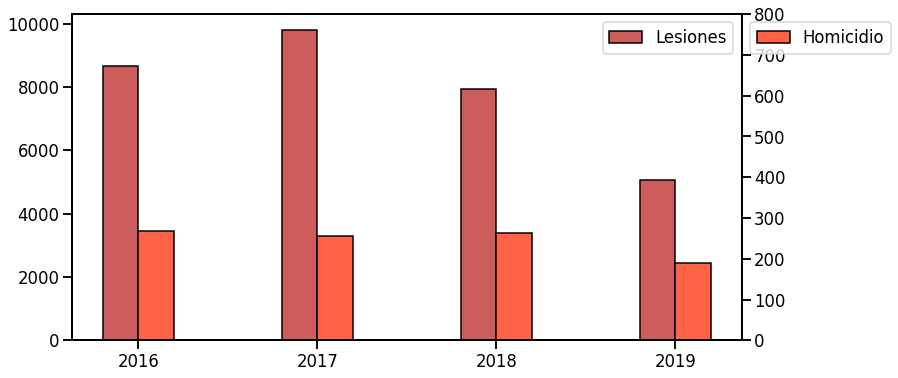

In [27]:
w = 0.2
fig, ax1 = plt.subplots(figsize = (12,6))
lesiones_por_año = ax1.bar(lesiones.Año-w/2, lesiones.Cantidad,color = 'indianred' ,width = w, label = 'Lesiones', ec = 'k')
plt.legend(loc=1, bbox_to_anchor=(1, 1))
ax2=ax1.twinx()
homicidios_por_año = ax2.bar(homicidios.Año+w/2, homicidios.Cantidad,color = 'tomato' ,width = w, label = 'Homicidio', ec = 'k')
ax3 = ax2.set(ylim=(0, 800))
plt.legend(loc=2, bbox_to_anchor=(1, 1))
plt.xticks([2016,2017,2018,2019])
plt.show()

## Importamos un nuevo Dataset "info_barrios", que brinda información demográfica sobre cada barrio de la ciudad
#### Cálculo indices de delictividad (por población y por densidad)

In [28]:
Info_Barrios = pd.read_excel('Info_Barrios.xlsx')

In [29]:
Delitos_2019 = Delitos_full.loc[Delitos_full.Año == 2019]
Delitos_2019 = Delitos_2019.groupby(by = Delitos_2019.Barrio)['Cantidad'].sum().to_frame()
Delitos_2019 = Delitos_2019.merge(Info_Barrios,left_on = 'Barrio', right_on = 'Barrio', how = 'left')
Delitos_2019['indice_por_poblacion'] = ((Delitos_2019.Cantidad / Delitos_2019.Poblacion)*100).round(2)
Delitos_2019['indice_por_densidad'] = ((Delitos_2019.Cantidad / Delitos_2019.Densidad)*100).round(2)
Delitos_2019 = Delitos_2019.sort_values(by = 'indice_por_poblacion', ascending = False)
Delitos_2019.head()

,Barrio,Cantidad,Comuna,Poblacion,Superficie,Densidad,indice_por_poblacion,indice_por_densidad
31,San Nicolás,6246.0,1,29273,2.289646,12784.946328,21.34,48.85
11,Constitución,3592.0,1,44107,2.102996,20973.408593,8.14,17.13
16,Monserrat,3227.0,1,39914,2.198012,18159.136759,8.08,17.77
32,San Telmo,1595.0,1,20453,1.232003,16601.427106,7.80,9.61
2,Balvanera,9238.0,3,138926,4.342658,31991.007052,6.65,28.88


## Ranking de los barrios con mayor cantidad de delitos por habitante
Vemos que palermo, que se encontraba en el puesto 1 en cantidad de delitos, pasa al puesto 10 en delitos por habitante

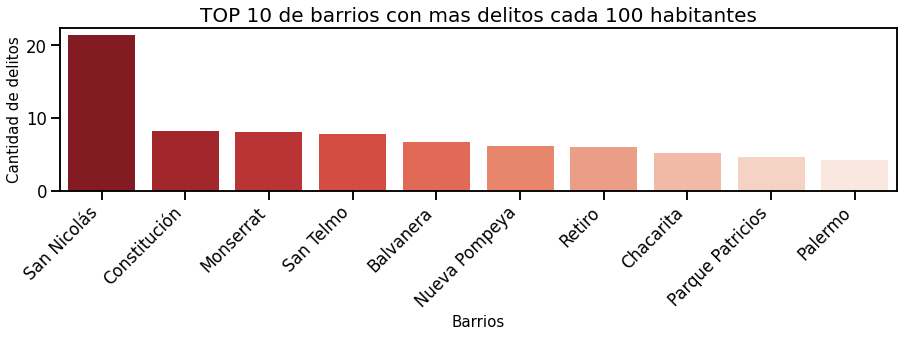

In [30]:
diverging_colors = sns.color_palette("Reds_r", 10) # Color de las barras
plt.figure(figsize=(15,3))
# Indicamos la columna 'Category', de los datos 'google_df', en el orden 'idx_top'
g = sns.barplot(x="Barrio",y = "indice_por_poblacion" ,data=Delitos_2019.iloc[0:10], palette = diverging_colors)
g.set_xticklabels(g.get_xticklabels(), rotation=45, ha="right")
plt.title('TOP 10 de barrios con mas delitos cada 100 habitantes', size = 20)
plt.xlabel("Barrios", size = 15)
plt.ylabel("Cantidad de delitos", size = 15)
plt.show()

## Mapa interactivo que permite visualizar las zonas con mas cantidad de delitos de Buenos Aires

In [31]:
mapa_calor = Delitos_full

In [32]:
latitude = -34.61315 
longitude = -58.37723
mapa = folium.Map(location=[latitude, longitude], zoom_start=12)
# Ensure you're handing it floats
mapa_calor['Latitud'] = mapa_calor['Latitud'].astype(float)
mapa_calor['Longitud'] = mapa_calor['Longitud'].astype(float)

# List comprehension to make out list of lists
heat_data = [[row['Latitud'],row['Longitud']] for index, row in mapa_calor.iterrows()]

HeatMap(heat_data, radius = 8.7).add_to(mapa)
mapa

## Top 20 barrios mas peligrosos

/Users/federicogirola/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


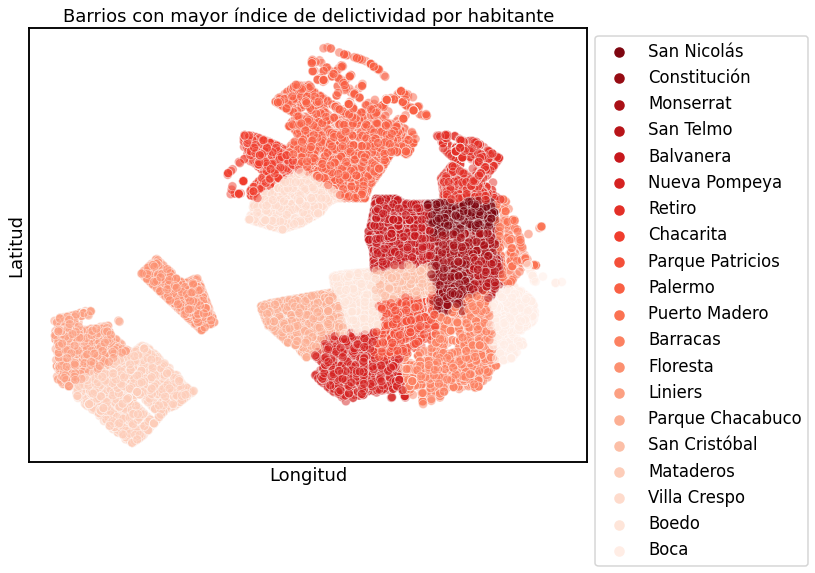

In [33]:
peligrosos = list(Delitos_2019.Barrio.iloc[0:20])
mas_peligrosos19 = Delitos_full.loc[(Delitos_full.Año == 2019) & (Delitos_full.Barrio.isin(peligrosos))]
#grafico scatterplot de los barrios mas delictivos
diverging_colors = sns.color_palette("Reds_r", 20)
plt.figure(figsize=(10,8))
sns.scatterplot(mas_peligrosos19.Longitud,mas_peligrosos19.Latitud,hue=mas_peligrosos19.Barrio,palette=diverging_colors, alpha=0.5, hue_order = peligrosos)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.title('Barrios con mayor índice de delictividad por habitante')
plt.xticks([])
plt.yticks([])
plt.show()

In [34]:
Delitos_full.to_excel('Delitos_full.xlsx')